# Jupyter Book rendering demo 

JupyterBook allows for rendering of notebooks as static HTML that can be rendered on github pages. This notebook demonstrates some of the more advanced rendering available within a notebook that doesn't require a kernel back-end. 

This notebook is therefore a demo of the potential benefits that could be gained if Max Fordham rendered project information in website form. 

## Datafames

### Scrollable rows and columns

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns

bigdf = pd.DataFrame(np.random.randn(16, 100))
bigdf.style.set_sticky(axis="index")
bigdf.index = pd.MultiIndex.from_product([["A","B"],[0,1],[0,1,2,3]])
bigdf.style.set_sticky(axis="index", pixel_size=18, levels=[1,2])

### Styling

In [4]:

def magnify():
    return [dict(selector="th",
                 props=[("font-size", "4pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

np.random.seed(25)
cmap = cmap=sns.diverging_palette(5, 250, as_cmap=True)
bigdf = pd.DataFrame(np.random.randn(20, 25)).cumsum()

bigdf.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '1pt'})\
    .set_caption("Hover to magnify")\
    .set_table_styles(magnify())

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,0.228273,1.026890,-0.839585,-0.591182,-0.956888,-0.222326,-0.619915,1.837905,-2.053231,0.868583,-0.920734,-0.232312,2.152957,-1.334661,0.076380,-1.246089,1.202272,-1.049942,1.056610,-0.419678,2.294842,-2.594487,2.822756,0.680889,-1.577693
1,-1.747981,1.560230,-1.130455,-1.104701,1.025738,0.003675,-2.459820,3.445575,-1.664939,1.268315,-0.515258,-0.015310,1.519518,-1.088040,-1.863166,-1.132030,-0.683069,-0.806861,0.351129,-0.055050,1.791890,-2.820239,2.257219,0.784284,0.440715
2,-0.653732,3.222665,-1.757908,0.516498,2.203870,-0.371203,-3.004149,3.733337,-1.870759,2.458303,0.213669,-0.237350,-0.103188,-0.775499,-3.023587,-0.818470,-0.211071,-0.228999,0.856536,-0.681538,1.445521,-4.886181,3.026155,1.913150,0.607639
3,-1.620988,3.714661,-2.308765,0.431804,4.171439,-0.433878,-3.855285,4.159857,-2.148320,1.080358,0.118473,0.596289,-0.887942,0.270645,-3.669371,-2.710049,-0.308404,-1.587895,1.354846,-1.828858,0.909000,-5.802670,2.814007,2.105995,0.284955
4,-3.348641,4.478728,-1.863451,-1.703772,5.191803,-1.021275,-3.807248,4.720027,-0.724127,1.077167,-0.179294,0.829012,-0.215989,-1.075636,-4.271094,-2.879245,-0.966785,-1.783919,1.532398,-1.796564,2.212258,-6.342154,3.343925,2.488792,2.085578
5,-0.835023,4.233717,-1.654723,-2.004623,5.344795,-0.990296,-4.132202,3.942754,-1.061569,-0.943343,1.240477,0.087122,-1.775907,-0.109346,-4.453389,-0.851705,-2.057086,-1.353887,0.801447,-1.632429,1.539048,-6.510822,2.802080,2.136327,3.774363
6,-0.742661,5.354728,-2.105947,-1.132570,4.202655,-1.849968,-3.201510,3.764827,-3.219971,-1.232603,0.335696,0.574738,-1.817876,0.540041,-4.434264,-1.829508,-4.029952,-2.620025,-0.199518,-4.682319,1.933769,-8.458161,3.335411,2.515490,5.814434
7,-0.435425,4.685541,-2.302523,-0.209710,5.929903,-2.625028,-1.834755,5.458698,-4.502776,-3.164846,-1.727800,0.179197,0.107779,0.036326,-5.992569,-0.449496,-6.199288,-3.889734,0.705826,-3.945140,0.673408,-7.256618,2.967961,3.394341,6.658520
8,0.916429,5.801350,-3.332729,-0.653992,5.987326,-3.187774,-1.830254,5.632341,-3.532148,-1.297564,-1.607920,0.819819,-2.445732,-0.403640,-6.055523,-0.516571,-6.595947,-3.484149,-0.043367,-4.599056,0.506327,-5.846181,3.227209,2.404915,5.075509
9,0.376610,5.536388,-4.489246,-0.801407,7.050450,-2.638456,-0.442983,5.346094,-1.958536,-0.334609,-0.800901,0.257086,-3.369133,-0.817936,-6.051681,-2.613163,-8.454623,-4.452364,0.413516,-4.709704,1.892156,-6.928920,2.137670,3.000518,5.156884


## GeoJson with deck.gl rendering

In [5]:
"""
GeoJsonLayer
===========

Property values in Vancouver, Canada, adapted from the deck.gl example pages. Input data is in a GeoJSON format.

Reference: https://deckgl.readthedocs.io/en/latest/gallery/geojson_layer.html
"""

import pydeck as pdk

DATA_URL = "https://raw.githubusercontent.com/visgl/deck.gl-data/master/examples/geojson/vancouver-blocks.json"
LAND_COVER = [[[-123.0, 49.196], [-123.0, 49.324], [-123.306, 49.324], [-123.306, 49.196]]]

INITIAL_VIEW_STATE = pdk.ViewState(latitude=49.254, longitude=-123.13, zoom=11, max_zoom=16, pitch=45, bearing=0)

polygon = pdk.Layer(
    "PolygonLayer",
    LAND_COVER,
    stroked=False,
    # processes the data as a flat longitude-latitude pair
    get_polygon="-",
    get_fill_color=[0, 0, 0, 20],
)

geojson = pdk.Layer(
    "GeoJsonLayer",
    DATA_URL,
    opacity=0.8,
    stroked=False,
    filled=True,
    extruded=True,
    wireframe=True,
    get_elevation="properties.valuePerSqm / 20",
    get_fill_color="[255, 255, properties.growth * 255]",
    get_line_color=[255, 255, 255],
)

r = pdk.Deck(layers=[polygon, geojson], initial_view_state=INITIAL_VIEW_STATE)

r.to_html()

## Interactive visualisations

__plotly below, but Altair / Vega also available__

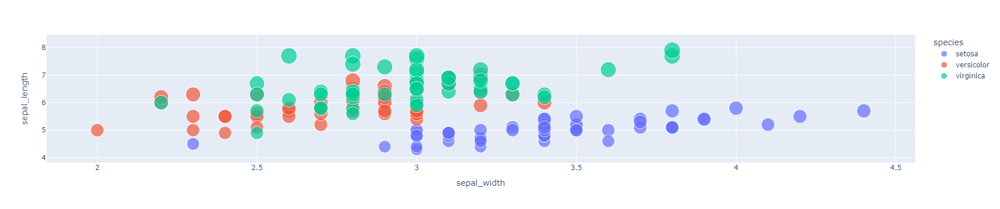

In [1]:
# https://plotly.com/python/getting-started/

import plotly.io as pio
import plotly.express as px

df = px.data.iris()
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species", size="sepal_length")
fig

## .obj 3d object rendering

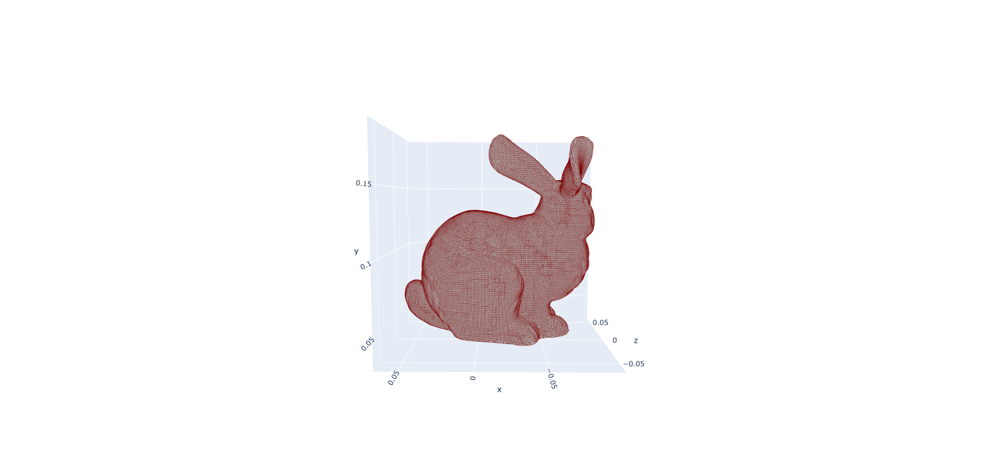

In [7]:
#  http://www2.compute.dtu.dk/projects/GEL/PyGEL/

from pygel3d import hmesh, gl_display as gl
from pygel3d import jupyter_display as jd

m = hmesh.load("data/bunny.obj")

jd.set_export_mode(True)
jd.display(m, smooth=False)

## PDF rendering

In [7]:
from IPython.display import HTML
fpth = "../_data/BMSDataDrivenWaterfall_resize.pdf"
HTML(f"""
<div class="admonition note" name="html-admonition" style="background: lightgreen; padding: 10px">
<p class="title">This is an example of an embedded pdf</p>
<iframe src="{fpth}" width="100%" height="800px" frameBorder="0"> </iframe>
""")
